# Two body, 2D Orbit

Defines a LagrangianPendulum class that is used to generate basic pendulum plots from solving Lagrange's equations.

* Last revised 22-April-2019 by Lucas D. Smith (smith.10444@osu.edu).

Newton's Law of gravitation tells us that two massive bodies are attracted to by a force proportional to the product of their masses and inversely proporional to the square of their distance apart:

$\begin{align}
\vec F_{12} = \dfrac{- G m_{1} m_{2}}{r_{12}^{2}} \hat r_{12}
\end{align}$

This force is conservative, thus we can find a scalar potential energy $U$, such that $\vec F = -\nabla U$

$\begin{align}
U = \dfrac{- G m_{1} m_{2}}{r_{12}}
\end{align}$

In cartesian coordinates, where $r_{12} = \sqrt{(x_{1} - x_{2})^{2} + (y_{1} - y_{2})^{2}} $

$\begin{align}
U = \frac{- G m_{1} m_{2}}{\sqrt{(x_{1} - x_{2})^{2} + (y_{1} - y_{2})^{2}}}
\end{align}$

Thus, the Lagrangian, $\mathcal{L} = T - U$, is

$\begin{align}
\mathcal{L} = \frac{1}{2} m_{1} (\dot x_{1}^{2} + \dot y_{1}^{2}) +
              \frac{1}{2} m_{2} (\dot x_{2}^{2} + \dot y_{2}^{2}) +
              \frac{G m_{1} m_{2}}{\sqrt{(x_{1} - x_{2})^{2} + (y_{1} - y_{2})^{2}}}              
\end{align}$

From the Euler-Lagrange Equations we can derive the equations of motion for each cartesian coordinate, $\ddot x_{1}, \ddot y_{1}, \ddot x_{2}, \ddot y_{2}$ 

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot x_{1}} = \frac{\partial\mathcal L}{\partial x_{1}}
 \quad\Longrightarrow\quad \ddot x_{1} = \frac{-G m_{2} (x_{1} - x_{2})}{r_{12}^{3}}
\end{align}$

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot y_{1}} = \frac{\partial\mathcal L}{\partial y_{1}}
 \quad\Longrightarrow\quad \ddot y_{1} = \frac{-G m_{2} (y_{1} - y_{2})}{r_{12}^{3}}
\end{align}$

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot x_{2}} = \frac{\partial\mathcal L}{\partial x_{2}}
 \quad\Longrightarrow\quad \ddot x_{2} = \frac{G m_{1} (x_{1} - x_{2})}{r_{12}^{3}}
\end{align}$

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot y_{2}} = \frac{\partial\mathcal L}{\partial y_{2}}
 \quad\Longrightarrow\quad \ddot y_{2} = \frac{G m_{1} (y_{1} - y_{2})}{r_{12}^{3}}
\end{align}$

These equations are numerically solved to show the animation below.

In [1]:
%matplotlib inline

In [2]:
import numpy as np
from scipy.integrate import odeint, solve_ivp

import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
import matplotlib.image as mpimg

In [3]:
# The dpi (dots-per-inch) setting will affect the resolution and how large
#  the plots appear on screen and printed.  So you may want/need to adjust 
#  the figsize when creating the figure.
plt.rcParams['figure.dpi'] = 100.    # this is the default for notebook

# Change the common font size (smaller when higher dpi)
font_size = 10
plt.rcParams.update({'font.size': font_size})

## Orbit class and utility functions

In [4]:
class Orbit():
    """
    Pendulum class implements the parameters and Lagrange's equations for 
     a simple pendulum (no driving or damping).
     
    Parameters
    ----------
    L : float
        length of the simple pendulum
    g : float
        gravitational acceleration at the earth's surface
    omega_0 : float
        natural frequency of the pendulum (\sqrt{g/l} where l is the 
        pendulum length) 
    mass : float
        mass of pendulum

    Methods
    -------
    dy_dt(t, y)
        Returns the right side of the differential equation in vector y, 
        given time t and the corresponding value of y.
    """
    def __init__(self, m1=1., m2=1., G=1.
                ):
        self.m1 = m1
        self.m2 = m2
        self.G = G
        
    def dy_dt(self, t, z):
        """
        This function returns the right-hand side of the diffeq: 
        [dphi/dt d^2phi/dt^2]
        
        Parameters
        ----------
        t : float
            time 
        y : float
            An 8-component vector with z[0] = x1
                                       z[1] = x1dot  
                                       z[2] = y1
                                       z[3] = y1dot
                                       z[4] = x2
                                       z[5] = x2dot  
                                       z[6] = y2
                                       z[7] = y2dot
        Returns
        -------
        
        """
        
        dist = np.sqrt((z[0] - z[4])**2 + (z[2] - z[6])**2)
        
        return [z[1],\
                -self.G*self.m2*(z[0] - z[4])/(dist**3), \
                z[3],\
                -self.G*self.m2*(z[2] - z[6])/(dist**3), \
                z[5],\
                self.G*self.m1*(z[0] - z[4])/(dist**3), \
                z[7],\
                self.G*self.m1*(z[2] - z[6])/(dist**3)]
    
    def solve_ode(self, t_pts, x1_0, x1dot_0, y1_0, y1dot_0, x2_0, x2dot_0, y2_0, y2dot_0, 
                  abserr=1.0e-9, relerr=1.0e-9):
        """
        Solve the ODE given initial conditions.
        Specify smaller abserr and relerr to get more precision.
        """
        z = [x1_0, x1dot_0, y1_0, y1dot_0, x2_0, x2dot_0, y2_0, y2dot_0] 
        solution = solve_ivp(self.dy_dt, (t_pts[0], t_pts[-1]), 
                             z, t_eval=t_pts, 
                             atol=abserr, rtol=relerr)
        x1, x1dot, y1, y1dot, x2, x2dot, y2, y2dot = solution.y

        return x1, x1dot, y1, y1dot, x2, x2dot, y2, y2dot

In [5]:
def plot_y_vs_x(x, y, axis_labels=None, label=None, title=None, 
                color=None, linestyle=None, semilogy=False, loglog=False,
                ax=None):
    """
    Generic plotting function: return a figure axis with a plot of y vs. x,
    with line color and style, title, axis labels, and line label
    """
    if ax is None:        # if the axis object doesn't exist, make one
        ax = plt.gca()

    if (semilogy):
        line, = ax.semilogy(x, y, label=label, 
                            color=color, linestyle=linestyle)
    elif (loglog):
        line, = ax.loglog(x, y, label=label, 
                          color=color, linestyle=linestyle)
    else:
        line, = ax.plot(x, y, label=label, 
                    color=color, linestyle=linestyle)

    if label is not None:    # if a label if passed, show the legend
        ax.legend()
    if title is not None:    # set a title if one if passed
        ax.set_title(title)
    if axis_labels is not None:  # set x-axis and y-axis labels if passed  
        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])

    return ax, line

In [6]:
def start_stop_indices(t_pts, plot_start, plot_stop):
    start_index = (np.fabs(t_pts-plot_start)).argmin()  # index in t_pts array 
    stop_index = (np.fabs(t_pts-plot_stop)).argmin()  # index in t_pts array 
    return start_index, stop_index

In [7]:
def start_stop_indices(t_pts, plot_start, plot_stop):
    start_index = (np.fabs(t_pts-plot_start)).argmin()  # index in t_pts array 
    stop_index = (np.fabs(t_pts-plot_stop)).argmin()  # index in t_pts array 
    return start_index, stop_index

## Make simple orbit plot 

In [8]:
# Common plotting time (generate the full time then use slices)
t_start = 0.
t_end = 100.
delta_t = 0.001

t_pts = np.arange(t_start, t_end+delta_t, delta_t)  

G = 1.
m1 = 1.
m2 = 100.

# Instantiate an orbit
o1 = Orbit(G=G, m1=m1, m2=m2)


In [9]:
x1_0 = 0.
x2_0 = 1.
y1_0 = 0.
y2_0 = 0.
x1dot_0 = 0.
x2dot_0 = 0.
y1dot_0 = -5.
y2dot_0 = -m1*(y1dot_0)/m2

x1, x1dot, y1, y1dot, x2, x2dot, y2, y2dot = o1.solve_ode(t_pts,\
                                        x1_0, x1dot_0, y1_0, y1dot_0, x2_0, x2dot_0, y2_0, y2dot_0)


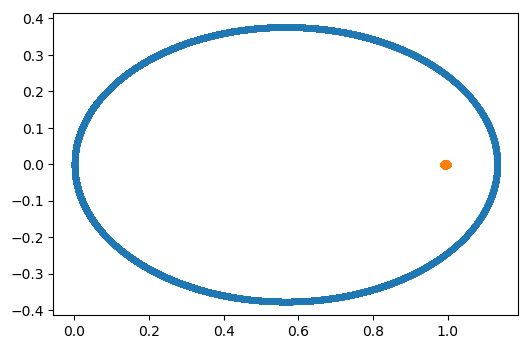

In [10]:
plt.plot(x1, y1, '.')
plt.plot(x2, y2, '.')

In [11]:
%%capture

fig_anim = plt.figure(figsize=(18,6))
ax_anim = fig_anim.add_subplot(1,1,1)
gap = 0.1
ax_anim.set_xlim(-gap, 1.5)
ax_anim.set_ylim(-0.5, 0.5)
ax_anim.set_aspect('equal')
ax_anim.axes

# By assigning the first return from plot to line_anim, we can later change
#  the values in the line.
line_anim1, = ax_anim.plot(x1_0, y1_0, marker='o', markersize = 20)
line_anim2, = ax_anim.plot(x2_0, y2_0, marker='o', markersize = 20)


fig_anim.tight_layout()

In [12]:
def animate_wave(i):
    """This is the function called by FuncAnimation to create each frame,
        numbered by i.  So each i corresponds to a point in the t_pts
        array, with index i.
    """
    x_1 = x1[i]
    y_1 = y1[i]
    x_2 = x2[i]
    y_2 = y2[i]
    
    line_anim1.set_data(x_1, y_1)  # overwrite line_anim with new points
    line_anim2.set_data(x_2, y_2)

    return (line_anim1,)   # this is needed for blit=True to work

In [13]:
frame_interval = 20.  # time between frames
frame_number = 1000    # number of frames to include (index of t_pts)
anim = animation.FuncAnimation(fig_anim, 
                               animate_wave, 
                               init_func=None,
                               frames=frame_number, 
                               interval=frame_interval, 
                               blit=True,
                               repeat=False)

#fig.show()

In [14]:
HTML(anim.to_jshtml())